## Introduction

Subscription services are leveraged by companies across many industries, from fitness to video streaming to retail. One of the primary objectives of companies with subscription services is to decrease churn and ensure that users are retained as subscribers. In order to do this efficiently and systematically, many companies employ machine learning to predict which users are at the highest risk of churn, so that proper interventions can be effectively deployed to the right audience.

In this project, I will be tackling the churn prediction problem on a very unique and interesting group of subscribers on a video streaming service.

### Train vs. Test
The data is available [here](https://www.coursera.org/learn/data-science-challenge/home/info).

The data is already split into train and test set.

`train.csv` contains 70% of the overall sample (243,787 subscriptions to be exact) and importantly, will reveal whether or not the subscription was continued into the next month (the “ground truth”).

The `test.csv` dataset contains the exact same information about the remaining segment of the overall sample (104,480 subscriptions to be exact) except the actual churn data. The goal of this project is to make prediction on each customer's churn.

### Dataset descriptions

In [1]:
import pandas as pd
data_descriptions = pd.read_csv('data_descriptions.csv')
pd.set_option('display.max_colwidth', None)
data_descriptions

,Column_name,Column_type,Data_type,Description
0,AccountAge,Feature,integer,The age of the user's account in months.
1,MonthlyCharges,Feature,float,The amount charged to the user on a monthly basis.
2,TotalCharges,Feature,float,The total charges incurred by the user over the account's lifetime.
3,SubscriptionType,Feature,object,"The type of subscription chosen by the user (Basic, Standard, or Premium)."
4,PaymentMethod,Feature,string,The method of payment used by the user.
5,PaperlessBilling,Feature,string,Indicates whether the user has opted for paperless billing (Yes or No).
6,ContentType,Feature,string,"The type of content preferred by the user (Movies, TV Shows, or Both)."
7,MultiDeviceAccess,Feature,string,Indicates whether the user has access to the service on multiple devices (Yes or No).
8,DeviceRegistered,Feature,string,"The type of device registered by the user (TV, Mobile, Tablet, or Computer)."
9,ViewingHoursPerWeek,Feature,float,The number of hours the user spends watching content per week.


## Setup

In [2]:
import pandas as pd
import numpy as np
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.dummy import DummyClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, ConfusionMatrixDisplay
from scipy.stats import randint
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px
%matplotlib inline

## Load the Data

In [3]:
train_df = pd.read_csv("train.csv")
print('train_df Shape:', train_df.shape)
train_df.head()

train_df Shape: (243787, 21)


,AccountAge,MonthlyCharges,TotalCharges,SubscriptionType,PaymentMethod,PaperlessBilling,ContentType,MultiDeviceAccess,DeviceRegistered,ViewingHoursPerWeek,...,ContentDownloadsPerMonth,GenrePreference,UserRating,SupportTicketsPerMonth,Gender,WatchlistSize,ParentalControl,SubtitlesEnabled,CustomerID,Churn
0,20,11.055215,221.104302,Premium,Mailed check,No,Both,No,Mobile,36.758104,...,10,Sci-Fi,2.176498,4,Male,3,No,No,CB6SXPNVZA,0
1,57,5.175208,294.986882,Basic,Credit card,Yes,Movies,No,Tablet,32.450568,...,18,Action,3.478632,8,Male,23,No,Yes,S7R2G87O09,0
2,73,12.106657,883.785952,Basic,Mailed check,Yes,Movies,No,Computer,7.395160,...,23,Fantasy,4.238824,6,Male,1,Yes,Yes,EASDC20BDT,0
3,32,7.263743,232.439774,Basic,Electronic check,No,TV Shows,No,Tablet,27.960389,...,30,Drama,4.276013,2,Male,24,Yes,Yes,NPF69NT69N,0
4,57,16.953078,966.325422,Premium,Electronic check,Yes,TV Shows,No,TV,20.083397,...,20,Comedy,3.616170,4,Female,0,No,No,4LGYPK7VOL,0


In [41]:
test_df = pd.read_csv("test.csv")
print('test_df Shape:', test_df.shape)

test_df Shape: (104480, 20)


## Preprocess & EDA

In [5]:
train_df.isna().any()

AccountAge                  False
MonthlyCharges              False
TotalCharges                False
SubscriptionType            False
PaymentMethod               False
PaperlessBilling            False
ContentType                 False
MultiDeviceAccess           False
DeviceRegistered            False
ViewingHoursPerWeek         False
AverageViewingDuration      False
ContentDownloadsPerMonth    False
GenrePreference             False
UserRating                  False
SupportTicketsPerMonth      False
Gender                      False
WatchlistSize               False
ParentalControl             False
SubtitlesEnabled            False
CustomerID                  False
Churn                       False
dtype: bool

In [6]:
train_df.describe()

,AccountAge,MonthlyCharges,TotalCharges,ViewingHoursPerWeek,AverageViewingDuration,ContentDownloadsPerMonth,UserRating,SupportTicketsPerMonth,WatchlistSize,Churn
count,243787.000000,243787.000000,243787.000000,243787.000000,243787.000000,243787.000000,243787.000000,243787.000000,243787.000000,243787.000000
mean,60.083758,12.490695,750.741017,20.502179,92.264061,24.503513,3.002713,4.504186,12.018508,0.181232
std,34.285143,4.327615,523.073273,11.243753,50.505243,14.421174,1.155259,2.872548,7.193034,0.385211
min,1.000000,4.990062,4.991154,1.000065,5.000547,0.000000,1.000007,0.000000,0.000000,0.000000
25%,30.000000,8.738543,329.147027,10.763953,48.382395,12.000000,2.000853,2.000000,6.000000,0.000000
50%,60.000000,12.495555,649.878487,20.523116,92.249992,24.000000,3.002261,4.000000,12.000000,0.000000
75%,90.000000,16.238160,1089.317362,30.219396,135.908048,37.000000,4.002157,7.000000,18.000000,0.000000
max,119.000000,19.989957,2378.723844,39.999723,179.999275,49.000000,4.999989,9.000000,24.000000,1.000000


In [7]:
train_df.dtypes

AccountAge                    int64
MonthlyCharges              float64
TotalCharges                float64
SubscriptionType             object
PaymentMethod                object
PaperlessBilling             object
ContentType                  object
MultiDeviceAccess            object
DeviceRegistered             object
ViewingHoursPerWeek         float64
AverageViewingDuration      float64
ContentDownloadsPerMonth      int64
GenrePreference              object
UserRating                  float64
SupportTicketsPerMonth        int64
Gender                       object
WatchlistSize                 int64
ParentalControl              object
SubtitlesEnabled             object
CustomerID                   object
Churn                         int64
dtype: object

Check the classes for each categorical variable.

In [8]:
train_df["SubscriptionType"].unique()

array(['Premium', 'Basic', 'Standard'], dtype=object)

In [9]:
train_df["PaymentMethod"].unique()

array(['Mailed check', 'Credit card', 'Electronic check', 'Bank transfer'],
      dtype=object)

In [10]:
train_df["PaperlessBilling"].unique()

array(['No', 'Yes'], dtype=object)

In [11]:
train_df["ContentType"].unique()

array(['Both', 'Movies', 'TV Shows'], dtype=object)

In [12]:
train_df["MultiDeviceAccess"].unique()

array(['No', 'Yes'], dtype=object)

In [13]:
train_df["DeviceRegistered"].unique()

array(['Mobile', 'Tablet', 'Computer', 'TV'], dtype=object)

In [14]:
train_df["GenrePreference"].unique()

array(['Sci-Fi', 'Action', 'Fantasy', 'Drama', 'Comedy'], dtype=object)

In [15]:
train_df["Gender"].unique()

array(['Male', 'Female'], dtype=object)

In [16]:
train_df["ParentalControl"].unique()

array(['No', 'Yes'], dtype=object)

In [17]:
train_df["SubtitlesEnabled"].unique()

array(['No', 'Yes'], dtype=object)

Now, dummy code the categorical variables except CustomerID.

In [18]:
train_df_new = train_df
train_df_new = train_df.drop("CustomerID", axis=1)

In [19]:
categorical_columns = ['SubscriptionType', 'PaymentMethod', 'PaperlessBilling', 'ContentType', 'MultiDeviceAccess',
                      'DeviceRegistered', 'GenrePreference', 'Gender', 'ParentalControl', 'SubtitlesEnabled']

for col in categorical_columns:
    dummies = pd.get_dummies(train_df_new[col], prefix=col)
    train_df_new = pd.concat([train_df_new, dummies], axis=1)

train_df_new = train_df_new.drop(categorical_columns, axis=1)

Check the proportion of churn in the training set.

In [20]:
fig = px.histogram(train_df['Churn'].astype(str), color=train_df['Churn'].astype(str), title="Churn count")

# Calculate percentages
total_count = len(train_df)
percentage_labels = [(f'{churn}: {count / total_count:.2%}') for churn, count in train_df['Churn'].value_counts().items()]

# Add percentage as a caption
fig.update_layout(
    annotations=[
        dict(
            text=', '.join(percentage_labels),
            showarrow=False,
            x=0.5,
            y=1.1,
            font=dict(size=12),
        )
    ]
)

# Show the plot
fig.show()

## Make predictions (required)

In this project, I decided to use random forest classifier because
* the dataset is pretty large
* the datset has many variables to be considered
* I just learned in my class and wanted to try

In [21]:
X_train = train_df_new.drop("Churn", axis = 1)
y_train = train_df_new["Churn"]
model = RandomForestClassifier()
model.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [22]:
feature_importances = pd.Series(model.feature_importances_, index=X_train.columns).sort_values(ascending=False)

fig = px.bar(feature_importances)
fig.show()

There are clear differences between the important and non important variables. For the ones with importance > 0.04, check if there are any correlations between one another. 

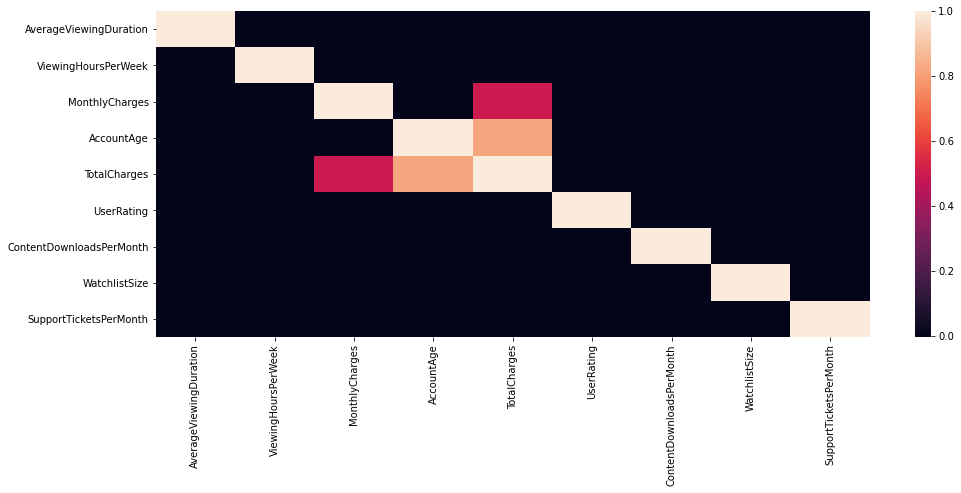

In [23]:
plt.figure(figsize=(16, 6))
important_variables = feature_importances[0:9].index
sns.heatmap(train_df[important_variables].corr())

The heatmap shows that there are correlations between "AccountAge" and "TotalCharges," and "MonthlyCharges" and "TotalCharges" which makes a lot of sense. Remove all the unimportant variables as well as "TotalCharges" from the model and run a new model. 

In [24]:
important_variables = important_variables.drop("TotalCharges")
X_train = train_df_new[important_variables]
y_train = train_df_new["Churn"]
model2 = RandomForestClassifier()
model2.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [25]:
feature_importances = pd.Series(model2.feature_importances_, index=X_train.columns).sort_values(ascending=False)

fig = px.bar(feature_importances)
fig.show()

Now that we identify the variables to include, we will move on to hypertune the model by determining the best parameters

In [26]:
# param_dist = {'n_estimators': randint(50,500),
#               'max_depth': randint(1,20)}

# rf = RandomForestClassifier()

# rand_search = RandomizedSearchCV(rf, 
#                                  param_distributions = param_dist, 
#                                  n_iter=5, 
#                                  cv=5)

# rand_search.fit(X_train, y_train)

In [27]:
# best_rf = rand_search.best_estimator_

# print('Best hyperparameters:',  rand_search.best_params_)

In [28]:
best_rf = RandomForestClassifier(max_depth = 13, n_estimators = 285)
best_rf.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=13, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=285,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

Using the model with the best parameters, we will finally make predictions on the test data.

In [29]:
X_test = test_df[important_variables]
y_pred = best_rf.predict(X_test)
prediction_df = pd.DataFrame({'CustomerID': test_df['CustomerID'], 'preds': y_pred})

## Post-process

In [30]:
fig = px.histogram(prediction_df.preds)
fig.show()

In [31]:
prediction_df.preds.value_counts()

0    102116
1      2364
Name: preds, dtype: int64

In [32]:
result = test_df
result['preds'] = prediction_df['preds']

Check how predicted churn is different for the variables with importance 

In [33]:
fig = px.box(x = result.preds, y = result.AverageViewingDuration)
fig.show()

You can see that the users who churned spend shorter amount of time watching a show/movie. Possible explanations are
* they do not like the contents on this platform or do not have time to watch, resulting in giving up before finishing them
* they prefer the contents of shorter duration (short films, an episode of a show)


In [34]:
fig = px.box(x = result.preds, y = result.ViewingHoursPerWeek)
fig.show()

Similarly, the churned users spent significantly less time using the streaming service.

In [35]:
fig = px.box(x = result.preds, y = result.MonthlyCharges)
fig.show()

The churn group pays higher subscription fee, which is a resonable incentive to cancel the plan.

In [36]:
fig = px.box(x = result.preds, y = result.AccountAge)
fig.show()

The users in the churned group did not use the platform for a long period of time.

In [38]:
fig = px.box(x = result.preds, y = result.ContentDownloadsPerMonth)
fig.show()

The users in the churned group do not take advantage of content downloading or might not be aware of the functionality, which explains their unsatisfaction. 

In [40]:
fig = px.box(x = result.preds, y = result.SupportTicketsPerMonth)
fig.show()

The number of support tickets are larger for the churned group. We can assume that they had trouble with the service or concern about their plan.

## Conclusion & Next Step

In this project, Random Forest Classifer was used to predict the customer churn on subscription service. First, the exploratory data analysis showed the potential relationship with the variables and the churn. Then, the model was developed and fine turned. The model used average viewing duration, viewing hours per week, montly charges, account age, user rating, content downloads per month, watchlist size, and support tickets per month as the variables with high importance. Since the test data does not contain the correct predictions, unfortunately, we were unable to see the prediction accuracy and the model performance. 

As the next step, we would like to test out different models, such as logistic regression, k-nearest neibors, decision tree classifier, and support vector machine, and compare the model performance. 